# eIF4F Optimization Overview

In [1]:
import alphastats 
import pandas as pd
import matplotlib.pyplot as plt

In [8]:
path = "G:/My Drive/Data/data/eIF4F optimization/protein intensities/"
loader_total = alphastats.GenericLoader(f"{path}total_href.csv", 
                                  intensity_column = '[Sample]',
                                   index_column="Protein.Group")

In [9]:
df_total = alphastats.DataSet(
    loader = loader_total,
    metadata_path = f"G:/My Drive/Data/data/eIF4F optimization/meta_8hour.xlsx",
    sample_column = 'Sample')

DataSet has been created.
Attributes of the DataSet can be accessed using: 
DataSet.rawinput:	 Raw Protein data.
DataSet.mat:		Processed data matrix with ProteinIDs/ProteinGroups as columns and samples as rows. All computations are performed on this matrix.
DataSet.metadata:	Metadata for the samples in the matrix. Metadata will be matched with DataSet.mat when needed (for instance Volcano Plot).


In [10]:
loader_nsp = alphastats.GenericLoader(f"{path}nsp_href.csv", 
                                  intensity_column = '[Sample]',
                                   index_column="Protein.Group")

In [11]:
df_nsp = alphastats.DataSet(
    loader = loader_nsp,
    metadata_path = f"G:/My Drive/Data/data/eIF4F optimization/meta_8hour.xlsx",
    sample_column = 'Sample')

DataSet has been created.
Attributes of the DataSet can be accessed using: 
DataSet.rawinput:	 Raw Protein data.
DataSet.mat:		Processed data matrix with ProteinIDs/ProteinGroups as columns and samples as rows. All computations are performed on this matrix.
DataSet.metadata:	Metadata for the samples in the matrix. Metadata will be matched with DataSet.mat when needed (for instance Volcano Plot).


In [12]:
# preprocess data, log2 transform
df_total.preprocess(subset=True)
df_nsp.preprocess(subset=True)

Data has been log2-transformed.
Data has been log2-transformed.


In [13]:
df_total.metadata

,Run,Sample,Auxin,Labeling time,EIF4F,eIF4F
0,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_33,eIF4E+ 8h 1,Positive,8h,eIF4E,eIF4E+
1,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_34,eIF4E+ 8h 2,Positive,8h,eIF4E,eIF4E+
2,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_35,eIF4G1+ 8h 1,Positive,8h,eIF4G1,eIF4G1+
3,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_36,eIF4G1+ 8h 2,Positive,8h,eIF4G1,eIF4G1+
4,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_37,eIF4G2+ 8h 1,Positive,8h,eIF4G2,eIF4G2+
5,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_38,eIF4G2+ 8h 2,Positive,8h,eIF4G2,eIF4G2+
6,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_39,eIF4G3+ 8h 1,Positive,8h,eIF4G3,eIF4G3+
7,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_40,eIF4G3+ 8h 2,Positive,8h,eIF4G3,eIF4G3+
8,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_41,eIF4E- 8h 1,Negative,8h,eIF4E,eIF4E-
9,Janice_20230525_RJK_HS_VNEO3_eIF4F_SsiDIA_42,eIF4E- 8h 2,Negative,8h,eIF4E,eIF4E-


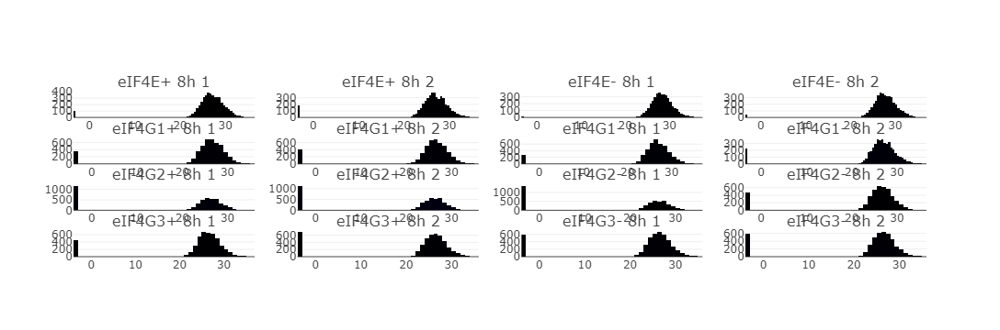

In [14]:
df_total.plot_samplehistograms().update_layout(plot_bgcolor="white", paper_bgcolor="white", height=1200)

In [15]:
# will use imputation but note that there should be a step in the pipeline to remove empty rows since there are many of them, especially a problem in the nsp df
df_total.preprocess(imputation='knn')

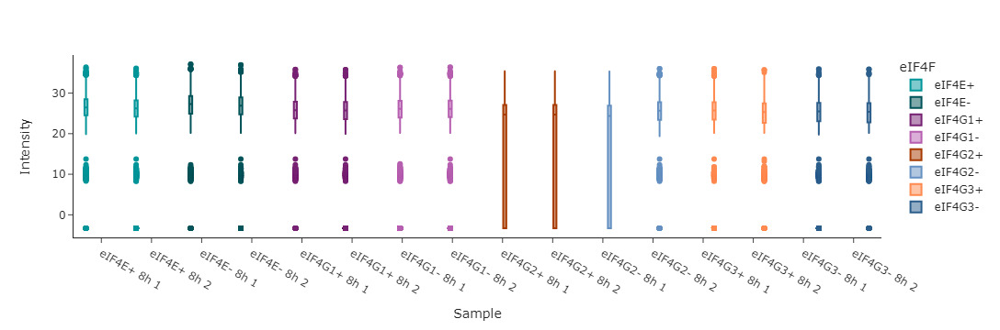

In [17]:
# Distribution plot of total intensity
distribution_plot = df_total.plot_sampledistribution(color='eIF4F', method="box")
distribution_plot.update_layout(plot_bgcolor="white", paper_bgcolor="white", height=500)

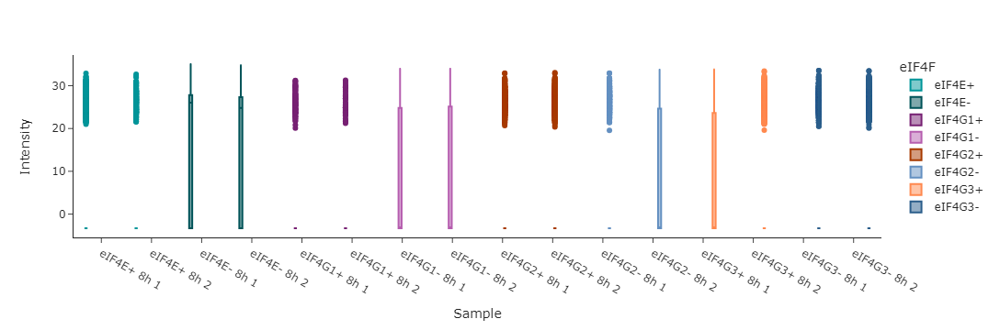

In [18]:
# Distribution plot of total intensity
distribution_plot = df_nsp.plot_sampledistribution(color='eIF4F', method="box")
distribution_plot.update_layout(plot_bgcolor="white", paper_bgcolor="white", height=500)

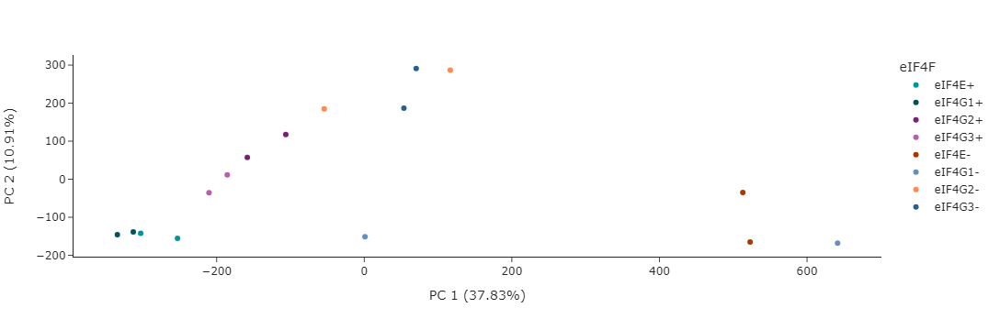

In [19]:
# PCA of total df
pca = df_total.plot_pca(group='eIF4F')  #.update_layout(plot_bgcolor="white", paper_bgcolor="white")
pca.update_layout(plot_bgcolor="white", paper_bgcolor="white", height=500)

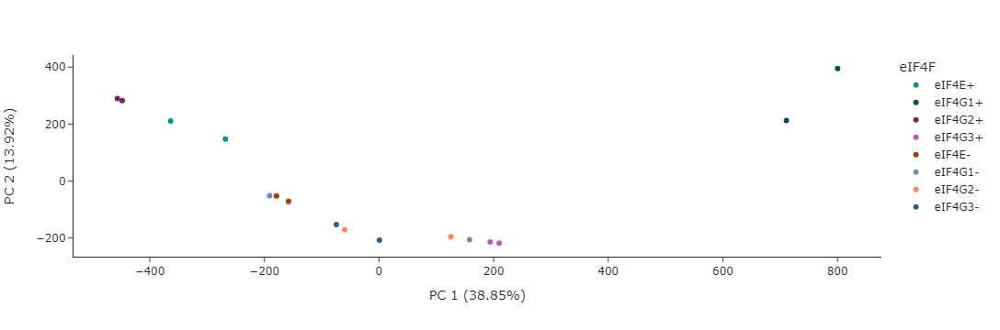

In [21]:
# PCA of total df
pca = df_nsp.plot_pca(group='eIF4F')  #.update_layout(plot_bgcolor="white", paper_bgcolor="white")
pca.update_layout(plot_bgcolor="white", paper_bgcolor="white", height=500)

C:\Users\Robbie\miniconda3\envs\silac_dia_statistics\lib\site-packages\alphastats\plots\IntensityPlot.py:68: RuntimeWarning:

Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.



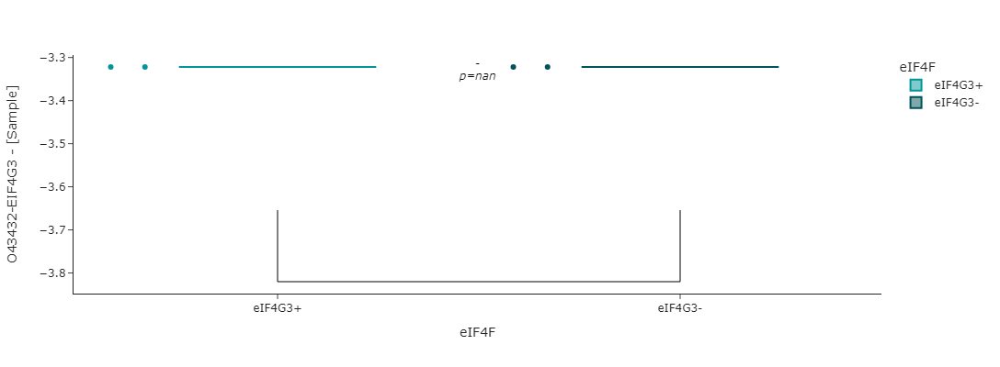

In [38]:

plot = df_total.plot_intensity(
    method="all",
    protein_id="O43432-EIF4G3", 
    group="eIF4F", # column in metadata
    #subgroups=["eIF4F-","eIF4F+"], # we only want to see T2DM and T2DM+NAFLD
    add_significance=True # add bar with pvalue
    )
plot.show

plot = df_total.plot_intensity(
    method="all",
    protein_id="O43432-EIF4G3", 
    group="eIF4F", # column in metadata
    subgroups=["eIF4G3-","eIF4G3+"], # we only want to see T2DM and T2DM+NAFLD
    add_significance=True # add bar with pvalue
    )
plot.update_layout(plot_bgcolor="white", paper_bgcolor="white", height=400)

C:\Users\Robbie\miniconda3\envs\silac_dia_statistics\lib\site-packages\alphastats\plots\IntensityPlot.py:68: RuntimeWarning:

Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.



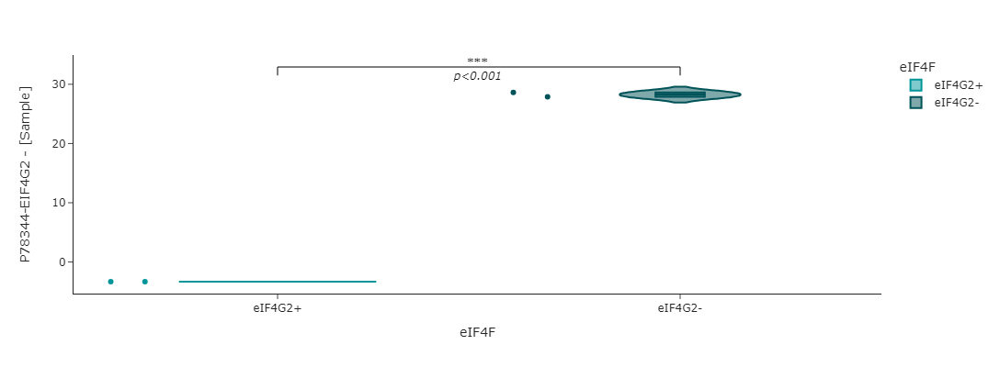

In [37]:

plot = df_total.plot_intensity(
    method="all",
    protein_id="P78344-EIF4G2", 
    group="eIF4F", # column in metadata
    subgroups=["eIF4G2-","eIF4G2+"], # we only want to see T2DM and T2DM+NAFLD
    add_significance=True # add bar with pvalue
    )
plot.update_layout(plot_bgcolor="white", paper_bgcolor="white", height=400)

C:\Users\Robbie\miniconda3\envs\silac_dia_statistics\lib\site-packages\alphastats\plots\IntensityPlot.py:68: RuntimeWarning:

Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.



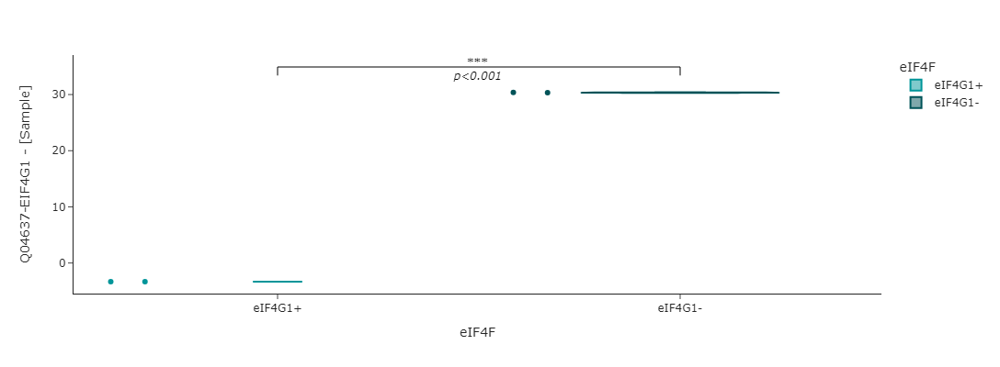

In [36]:
plot = df_total.plot_intensity(
    method="all",
    protein_id="Q04637-EIF4G1", 
    group="eIF4F", # column in metadata
    subgroups=["eIF4G1-","eIF4G1+"], # we only want to see T2DM and T2DM+NAFLD
    add_significance=True # add bar with pvalue
    )
plot.update_layout(plot_bgcolor="white", paper_bgcolor="white", height=400)

C:\Users\Robbie\miniconda3\envs\silac_dia_statistics\lib\site-packages\alphastats\plots\IntensityPlot.py:68: RuntimeWarning:

Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.



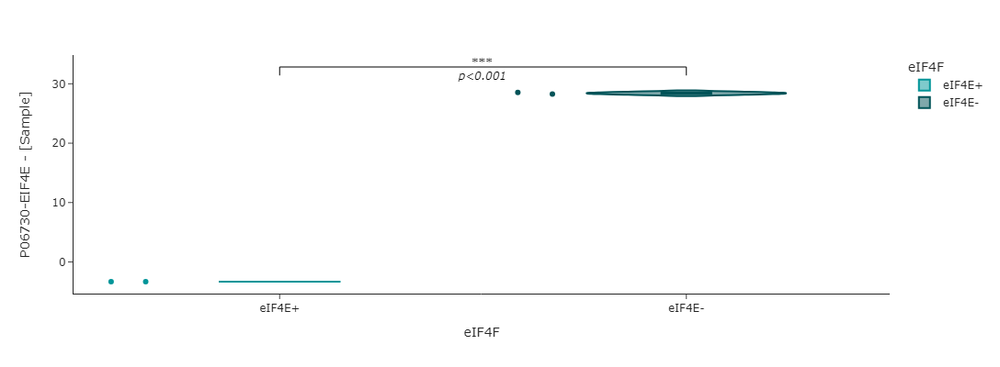

In [35]:

plot = df_total.plot_intensity(
    method="all",
    protein_id="P06730-EIF4E", 
    group="eIF4F", # column in metadata
    subgroups=["eIF4E-","eIF4E+"], # we only want to see T2DM and T2DM+NAFLD
    add_significance=True # add bar with pvalue
    )
plot.update_layout(plot_bgcolor="white", paper_bgcolor="white", height=400)

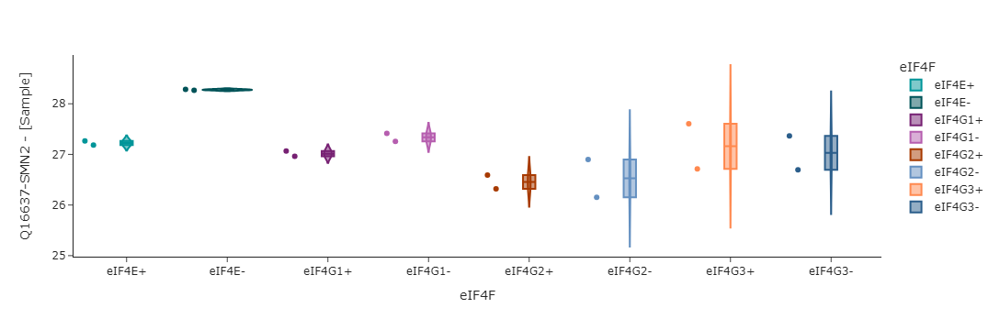

In [27]:

plot = df_total.plot_intensity(
    method="all",
    protein_id="Q16637-SMN2", 
    group="eIF4F", # column in metadata
    #subgroups=["eIF4F-","eIF4F+"], # we only want to see T2DM and T2DM+NAFLD
    add_significance=True # add bar with pvalue
    )
plot.show()

Calculating Students t-test...


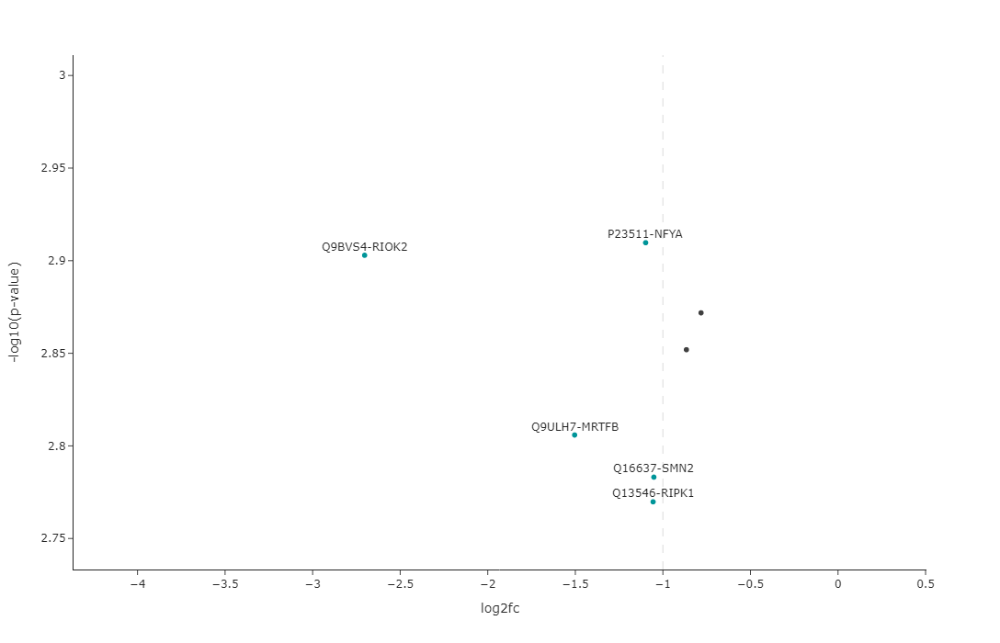

In [23]:
volcano_plot = df_total.plot_volcano(
    column="eIF4F", # column in metadata
    group1="eIF4E+",
    group2="eIF4E-",
    labels=True, # add label to significantly enriched proteins
    alpha=0.01 # cutoff for pvalue
)
volcano_plot.show()

In [68]:
import protein_levels_plots as protplot
import pandas as pd
path = "G:/My Drive/Data/data/eIF4F optimization/protein intensities/"

In [69]:
df = pd.read_csv(f"{path}total_href.csv")

In [70]:
df['Protein.Group'] = df['Protein.Group'].str.split('-').str[1]

In [71]:
df = df[df['Protein.Group']=="UBA6"]
df = df[df['Protein.Group']=="UBA6"]
df = df[df['Protein.Group']=="UBA6"]
df = df[df['Protein.Group']=="UBA6"]
df = df[df['Protein.Group']=="UBA6"]
df = df[df['Protein.Group']=="PTEN"]
#df = df[df['Protein.Group']=="TSC2"]


In [72]:
df.head()

,Protein.Group,eIF4E+ 2h 1,eIF4E+ 2h 2,eIF4E+ 4h 1,eIF4E+ 4h 2,eIF4E+ 8h 1,eIF4E+ 8h 2,eIF4E- 2h 1,eIF4E- 2h 2,eIF4E- 4h 1,...,eIF4G3+ 4h 1,eIF4G3+ 4h 2,eIF4G3+ 8h 1,eIF4G3+ 8h 2,eIF4G3- 2h 1,eIF4G3- 2h 2,eIF4G3- 4h 1,eIF4G3- 4h 2,eIF4G3- 8h 1,eIF4G3- 8h 2


In [11]:
nsp_df['Protein.Group'] = nsp_df['Protein.Group'].str.split('-').str[1]

In [12]:
nsp_df.head()

,Protein.Group,eIF4E+ 2h 1,eIF4E+ 2h 2,eIF4E+ 4h 1,eIF4E+ 4h 2,eIF4E+ 8h 1,eIF4E+ 8h 2,eIF4E- 2h 1,eIF4E- 2h 2,eIF4E- 4h 1,...,eIF4G3+ 4h 1,eIF4G3+ 4h 2,eIF4G3+ 8h 1,eIF4G3+ 8h 2,eIF4G3- 2h 1,eIF4G3- 2h 2,eIF4G3- 4h 1,eIF4G3- 4h 2,eIF4G3- 8h 1,eIF4G3- 8h 2
0,GATD3;GATD3B,4.698898e+08,6.328536e+08,4.258640e+08,2.026788e+08,3.095807e+08,2.694354e+08,3.426461e+08,3.852102e+08,2.326936e+08,...,7.407649e+07,7.159018e+07,1.547078e+08,1.222099e+08,7.947711e+07,1.059588e+08,9.500303e+07,9.832495e+07,1.125135e+08,1.334364e+08
1,PIGBOS1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.000000e+00,NaN,NaN,0.000000e+00,0.000000e+00,0.000000e+00,NaN
2,RBM47,7.220414e+07,1.533777e+08,7.618667e+07,3.548605e+07,NaN,4.938168e+07,6.410638e+07,8.583874e+07,1.969498e+07,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.200485e+07,0.000000e+00,0.000000e+00
3,UBA6,6.509754e+08,9.538365e+08,8.902106e+08,3.466559e+08,5.484464e+08,5.279882e+08,6.956351e+08,7.934446e+08,5.255978e+08,...,1.415461e+08,1.385174e+08,4.126805e+08,2.920502e+08,1.494317e+08,2.599083e+08,2.106399e+08,2.462628e+08,3.150737e+08,3.367855e+08
4,ESYT2,5.838995e+08,7.457399e+08,5.275371e+08,2.959497e+08,4.411471e+08,3.493663e+08,4.634829e+08,5.771637e+08,3.643659e+08,...,1.400129e+08,1.465443e+08,2.888879e+08,2.356884e+08,1.170989e+08,1.859116e+08,1.661058e+08,1.573224e+08,2.417589e+08,2.203244e+08


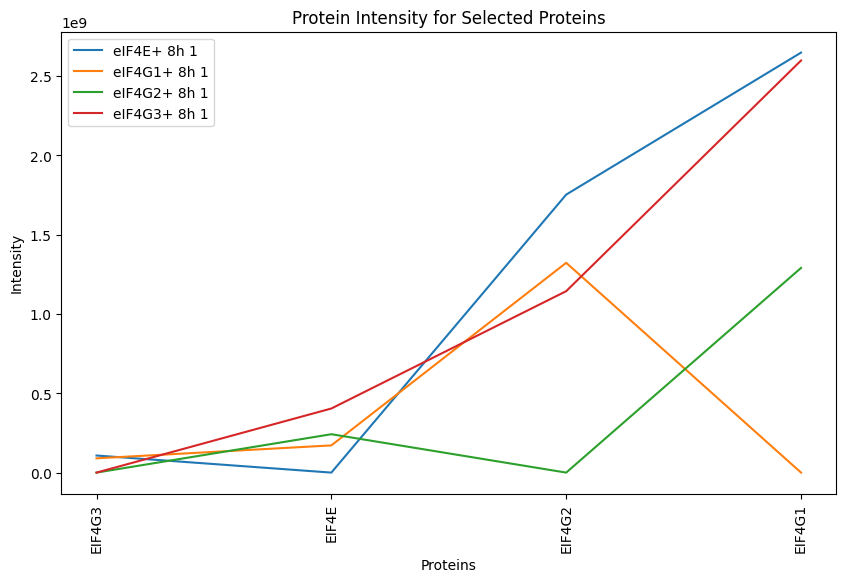

In [19]:
protein_list = ['EIF4E', 'EIF4G1', 'EIF4G2', 'EIF4G3']
samples = ['eIF4E+ 8h 1',  'eIF4G1+ 8h 1', 'eIF4G2+ 8h 1','eIF4G3+ 8h 1']
protplot.plot_proteins(nsp_df, protein_list, samples)

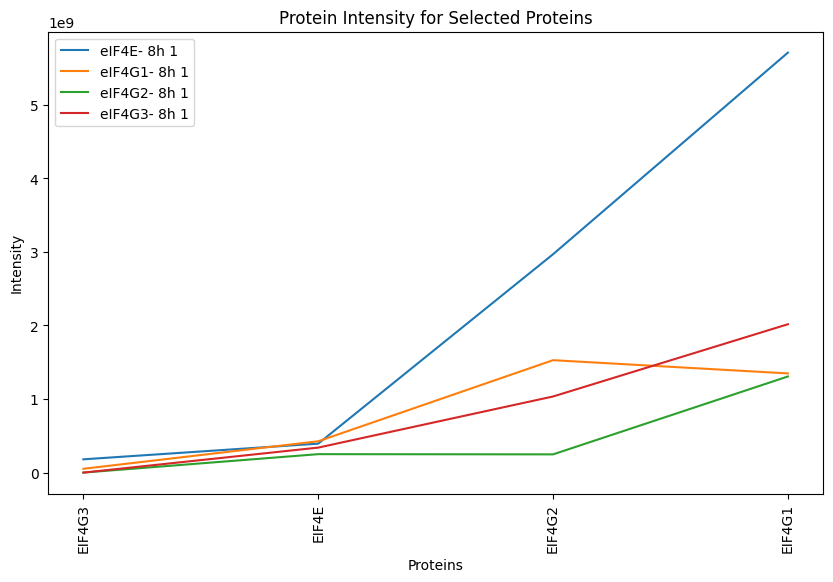

In [20]:
protein_list = ['EIF4E', 'EIF4G1', 'EIF4G2', 'EIF4G3']
samples = ['eIF4E- 8h 1',  'eIF4G1- 8h 1', 'eIF4G2- 8h 1','eIF4G3- 8h 1']
protplot.plot_proteins(nsp_df, protein_list, samples)